# Pull down the data we will work with

In [2]:
import requests
import pandas as pd
import time
import datetime

BASE = "https://min-api.cryptocompare.com/data/v2/histohour"
PAIR  = {"fsym": "BTC", "tsym": "USD", "limit": 2000}      # 2 000 = max bars per call

def fetch_all_histohour(pair=PAIR):
    frames = []
    params = pair.copy()
    to_ts  = None                          # when None we start from "now" and page back
    # Unix timestamp for January 1, 2012
    start_of_2012 = int(datetime.datetime(2012, 1, 1).timestamp())
    while True:
        if to_ts is not None:
            params["toTs"] = to_ts
        res = requests.get(BASE, params=params, timeout=15).json()
        batch = res["Data"]["Data"]
        print(batch)
        if not batch:                      # no more data → finished
            break
        if batch[0]["close"] is None:
            break
        # Check if we've reached data before 2012 or if close price is 0
        if batch[0]["time"] < start_of_2012 or batch[0]["close"] == 0:
            frames.append(pd.DataFrame(batch))  # Include the current batch
            break
        frames.append(pd.DataFrame(batch))
        to_ts = batch[0]["time"] - 1       # step back 1 s before oldest bar fetched
        time.sleep(0.25)                   # polite pause – keeps you far below free-tier limits
    df = pd.concat(frames, ignore_index=True)
    df["time"] = pd.to_datetime(df["time"], unit="s", utc=True)
    return df.sort_values("time").reset_index(drop=True)   # oldest-to-newest

df = fetch_all_histohour()
df.to_csv("btc_hourly_cryptocompare.csv", index=False)
print(df.head(), "\n", df.tail())

[{'time': 1740247200, 'high': 96821.36, 'low': 96414.72, 'open': 96632.75, 'volumefrom': 510.11, 'volumeto': 49306690.27, 'close': 96455.54, 'conversionType': 'direct', 'conversionSymbol': ''}, {'time': 1740250800, 'high': 96673.44, 'low': 96364.69, 'open': 96455.54, 'volumefrom': 388.58, 'volumeto': 37519306.68, 'close': 96646.1, 'conversionType': 'direct', 'conversionSymbol': ''}, {'time': 1740254400, 'high': 96662.45, 'low': 96525.15, 'open': 96646.1, 'volumefrom': 401.6, 'volumeto': 38792214.79, 'close': 96585.21, 'conversionType': 'direct', 'conversionSymbol': ''}, {'time': 1740258000, 'high': 96701.87, 'low': 96529.96, 'open': 96585.21, 'volumefrom': 373.86, 'volumeto': 36112854.73, 'close': 96689, 'conversionType': 'direct', 'conversionSymbol': ''}, {'time': 1740261600, 'high': 96733.41, 'low': 96607.56, 'open': 96689, 'volumefrom': 355.59, 'volumeto': 34375131.7, 'close': 96655.03, 'conversionType': 'direct', 'conversionSymbol': ''}, {'time': 1740265200, 'high': 96692.83, 'low'

<Axes: >

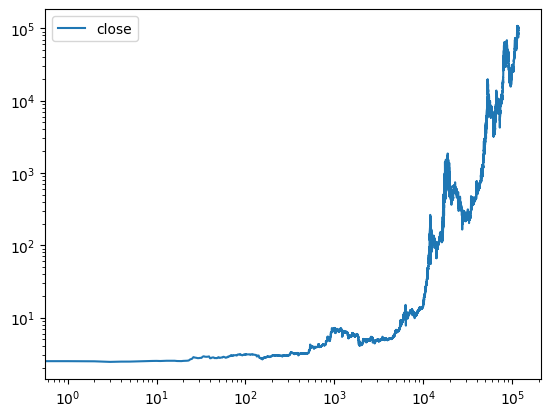

In [16]:
df[["close"]].plot(logy=True, logx=True)

---